<a href="https://colab.research.google.com/github/Anindyait/Big-Data-Project/blob/main/Exploratory_Data_Analysis_(EDA)_on_Spatio_temporal_Epidemics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Phase 1: Exploratory Data Analysis (EDA) on Spatio-temporal Epidemics (COVID-19)

Course: DAL-588 (Big Data and AI for Industry)
Group Members-
* Akriti Gulati - 24565002
* Anindya Biswas - 24565003
* Priya Gupta - 24565013
* Arpit Kumar Chaudhary - 24566006


##### This notebook focuses on Phase 1 of the project, which involves Exploratory Data Analysis (EDA) on Spatio-temporal Epidemics (COVID-19). The dataset contains detailed information about dataset :

    * Province/States
    * Country/Region
    * Lat
    * Long
    * Date
    * Confirmed
    * Deaths
    * Recovered
    * Active
    * WHO Region

## Installing Python Libraries

In [ ]:
! pip install calmap
! pip install folium
! pip install geoviews
!pip install cartopy
!pip install basemap

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.3/547.3 kB 7.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.7/11.7 MB 67.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 942.4/942.4 kB 17.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 60.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.6/11.6 MB 98.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 18.3/18.3 MB 86.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.0/53.0 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 62.6 MB/s eta 0:00:00
  Attempting uninstall: pyproj
    Found existing installation: pyproj 3.7.1
    Uninstalling pyproj-3.7.1:
      Successfully uninstalled pyproj-3.7.1
  Attempting uninstall: packaging
    Found existing installation: packaging 24.2
    Uninstalling packaging-24.2:
      Successfully un

### Importing necessary libraries & Loading the COVID-19 Dataset

In [1]:
import pandas as pd
details= pd.read_csv('covid_19_data.csv', parse_dates=['Date'])
details.sample(6)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
2955,NaN,Costa Rica,9.748900,-83.753400,2020-02-02,0,0,0,0,Americas
18940,NaN,Lithuania,55.169400,23.881300,2020-04-03,696,9,7,680,Europe
37022,NaN,United Kingdom,55.378100,-3.436000,2020-06-11,268657,41377,0,227280,Europe
11241,NaN,Bahamas,25.025885,-78.035889,2020-03-05,0,0,0,0,Americas
3501,Mayotte,France,-12.827500,45.166244,2020-02-04,0,0,0,0,Europe
23442,NaN,Ukraine,48.379400,31.165600,2020-04-20,5710,151,359,5200,Europe


In [ ]:
details.describe()

,Lat,Long,Date,Confirmed,Deaths,Recovered,Active
count,49068.000000,49068.000000,49068,4.906800e+04,49068.000000,4.906800e+04,4.906800e+04
mean,21.433730,23.528236,2020-04-24 12:00:00,1.688490e+04,884.179160,7.915713e+03,8.085012e+03
min,-51.796300,-135.000000,2020-01-22 00:00:00,0.000000e+00,0.000000,0.000000e+00,-1.400000e+01
25%,7.873054,-15.310100,2020-03-08 18:00:00,4.000000e+00,0.000000,0.000000e+00,0.000000e+00
50%,23.634500,21.745300,2020-04-24 12:00:00,1.680000e+02,2.000000,2.900000e+01,2.600000e+01
75%,41.204380,80.771797,2020-06-10 06:00:00,1.518250e+03,30.000000,6.660000e+02,6.060000e+02
max,71.706900,178.065000,2020-07-27 00:00:00,4.290259e+06,148011.000000,1.846641e+06,2.816444e+06
std,24.950320,70.442740,NaN,1.273002e+05,6313.584411,5.480092e+04,7.625890e+04


In [ ]:
details.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49068 entries, 0 to 49067
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   Province/State  14664 non-null  object        
 1   Country/Region  49068 non-null  object        
 2   Lat             49068 non-null  float64       
 3   Long            49068 non-null  float64       
 4   Date            49068 non-null  datetime64[ns]
 5   Confirmed       49068 non-null  int64         
 6   Deaths          49068 non-null  int64         
 7   Recovered       49068 non-null  int64         
 8   Active          49068 non-null  int64         
 9   WHO Region      49068 non-null  object        
dtypes: datetime64[ns](1), float64(2), int64(4), object(3)
memory usage: 3.7+ MB


In [ ]:
details.isna().sum()

,0
Province/State,34404
Country/Region,0
Lat,0
Long,0
Date,0
Confirmed,0
Deaths,0
Recovered,0
Active,0
WHO Region,0


In [ ]:
print(details.describe(include=['object']))

                      Province/State Country/Region WHO Region
count                          14664          49068      49068
unique                            78            187          6
top     Australian Capital Territory          China     Europe
freq                             188           6204      15040


### Converting 'Date' column to datetime format &  Extracting Year and Month

In [ ]:
# Converting 'Date' column to datetime format
details['Date'] = pd.to_datetime(details['Date'])

# Extracting Year and Month
details['Year'] = details['Date'].dt.year
details['Month'] = details['Date'].dt.month

In [ ]:
details.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Year,Month
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,2020,1
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2020,1
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,2020,1
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,2020,1
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,2020,1


### Adding new Columns

In [ ]:
# Creating an "Active Ratio" column
details["Active Ratio"] = details["Active"] / details["Confirmed"]

# Creating a "Fatality Rate" column
details["Fatality Rate"] = details["Deaths"] / details["Confirmed"]

In [ ]:
details.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Year,Month,Active Ratio,Fatality Rate
0,NaN,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,2020,1,NaN,NaN
1,NaN,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2020,1,NaN,NaN
2,NaN,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,2020,1,NaN,NaN
3,NaN,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,2020,1,NaN,NaN
4,NaN,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,2020,1,NaN,NaN


In [ ]:
details.shape

(49068, 14)

In [ ]:
print(details.describe())

                Lat          Long                 Date     Confirmed  \
count  49068.000000  49068.000000                49068  4.906800e+04   
mean      21.433730     23.528236  2020-04-24 12:00:00  1.688490e+04   
min      -51.796300   -135.000000  2020-01-22 00:00:00  0.000000e+00   
25%        7.873054    -15.310100  2020-03-08 18:00:00  4.000000e+00   
50%       23.634500     21.745300  2020-04-24 12:00:00  1.680000e+02   
75%       41.204380     80.771797  2020-06-10 06:00:00  1.518250e+03   
max       71.706900    178.065000  2020-07-27 00:00:00  4.290259e+06   
std       24.950320     70.442740                  NaN  1.273002e+05   

              Deaths     Recovered        Active     Year         Month  \
count   49068.000000  4.906800e+04  4.906800e+04  49068.0  49068.000000   
mean      884.179160  7.915713e+03  8.085012e+03   2020.0      4.281915   
min         0.000000  0.000000e+00 -1.400000e+01   2020.0      1.000000   
25%         0.000000  0.000000e+00  0.000000e+00   

### Count of cases by country

In [ ]:
print(details['Country/Region'].value_counts().head(10))

Country/Region
China                  6204
Canada                 2256
France                 2068
United Kingdom         2068
Australia              1504
Netherlands             752
Denmark                 376
Algeria                 188
Andorra                 188
Antigua and Barbuda     188
Name: count, dtype: int64


### Display of Top 10 Countries based on total Active case count

In [ ]:
# Count total active cases per country
active_cases_by_country = details.groupby('Country/Region', as_index=False)['Active'].sum()

# Sort by the highest active cases
active_cases_by_country = active_cases_by_country.sort_values(by='Active', ascending=False)

# Display the top 10 countries with the highest active cases without index
print(active_cases_by_country.head(10).to_string(index=False))



Country/Region    Active
            US 156981121
        Brazil  31094060
United Kingdom  22624595
        Russia  19668578
         India  15987913
        France  10980287
         Spain   9277432
        Canada   8656985
          Peru   7748957
         Italy   7363518


### Display of Top 10 Countries based on total Death case count

In [ ]:
# Count total death cases per country
active_cases_by_country = details.groupby('Country/Region', as_index=False)['Deaths'].sum()

# Sort by the highest death cases
active_cases_by_country = active_cases_by_country.sort_values(by='Deaths', ascending=False)

# Display the top 10 countries with the highest death cases without index
print(active_cases_by_country.head(10).to_string(index=False))


Country/Region   Deaths
            US 11011411
United Kingdom  3997775
        Brazil  3938034
         Italy  3707717
        France  3048524
         Spain  3033030
        Mexico  1728277
         India  1111831
          Iran  1024136
       Belgium   963679


### Extraxtion of Year from Date and group them by Country

In [ ]:
# Ensure 'Date' column is in datetime format
details['Date'] = pd.to_datetime(details['Date'])

# Extract 'Year' from 'Date'
details['Year'] = details['Date'].dt.year

# Group by 'Year' and 'Country/Region' and sum up the cases
yearly_country_summary = details.groupby(['Year', 'Country/Region'], as_index=False)[['Confirmed', 'Deaths', 'Recovered', 'Active']].sum()

# Compute Fatality Rate (Deaths per Confirmed cases) and Active Ratio (Active per Confirmed cases)
yearly_country_summary['Fatality Rate'] = (yearly_country_summary['Deaths'] / yearly_country_summary['Confirmed']) * 100
yearly_country_summary['Active Ratio'] = (yearly_country_summary['Active'] / yearly_country_summary['Confirmed']) * 100

# Display top 10 records without index
print(yearly_country_summary.head(10).to_string(index=False))


 Year      Country/Region  Confirmed  Deaths  Recovered  Active  Fatality Rate  Active Ratio
 2020         Afghanistan    1936390   49098     798240 1089052       2.535543     56.241356
 2020             Albania     196702    5708     118877   72117       2.901852     36.663074
 2020             Algeria    1179755   77972     755897  345886       6.609169     29.318460
 2020             Andorra      94404    5423      69074   19907       5.744460     21.087030
 2020              Angola      22662    1078       6573   15011       4.756862     66.238637
 2020 Antigua and Barbuda       4487     326       2600    1561       7.265433     34.789392
 2020           Argentina    4450658   97749    1680024 2672885       2.196282     60.055951
 2020             Armenia    1587173   27089     857482  702602       1.706745     44.267512
 2020           Australia     960247   11387     711928  236932       1.185841     24.674068
 2020             Austria    2034986   71390    1638380  325216       

### Cases Distribution
* #### Based on status

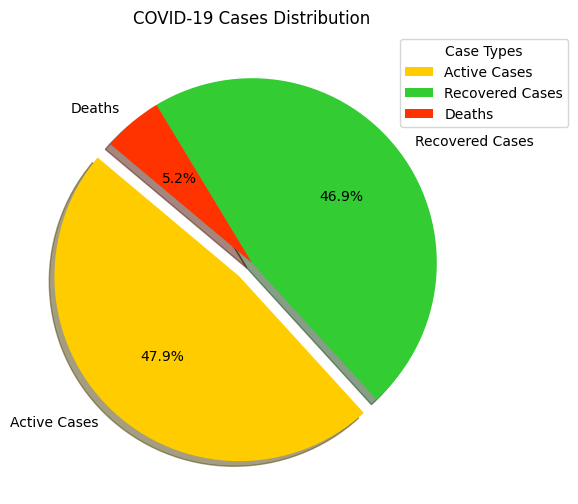

In [ ]:
# Import the necessary library
import matplotlib.pyplot as plt

# Aggregate total numbers across all records
total_confirmed = details['Confirmed'].sum()
total_deaths = details['Deaths'].sum()
total_recovered = details['Recovered'].sum()
total_active = details['Active'].sum()

# Data for pie chart
labels = ['Active Cases', 'Recovered Cases', 'Deaths']
sizes = [total_active, total_recovered, total_deaths]
colors = ['#ffcc00', '#33cc33', '#ff3300']
explode = (0.1, 0, 0)  # Explode the "Active Cases" section for emphasis

# Create Pie Chart
plt.figure(figsize=(8, 6))
wedges, texts, autotexts = plt.pie(
    sizes, labels=labels, autopct='%1.1f%%', colors=colors,
    explode=explode, shadow=True, startangle=140
)

# Add legend
plt.legend(wedges, labels, title="Case Types", loc="upper right", bbox_to_anchor=(1.2, 1))

# Add Title
plt.title('COVID-19 Cases Distribution')

# Show Plot
plt.show()


* Active cases in Top 10 Countries

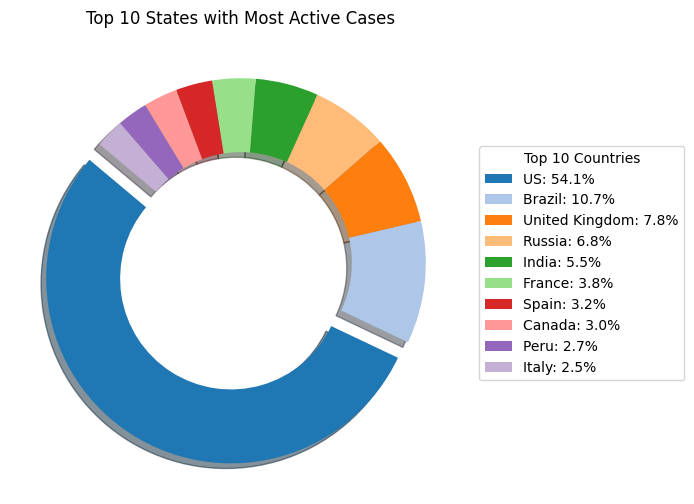

In [ ]:
# Group data by 'Countries' and sum the 'Active' cases
top_10_countries = details.groupby("Country/Region")["Active"].sum().nlargest(10)

# Data for the pie chart
labels = top_10_countries.index
sizes = top_10_countries.values
colors = plt.cm.tab20.colors
explode = [0.1 if i == 0 else 0 for i in range(10)]  # Highlight top state

# Create Pie Chart without text labels
plt.figure(figsize=(8, 6))
wedges, _ = plt.pie(
    sizes, colors=colors, explode=explode,
    shadow=True, startangle=140, wedgeprops={'width': 0.4}  # Corrected quote here
)

# Add legend with state names and percentages
percentages = [f"{label}: {size / sum(sizes) * 100:.1f}%" for label, size in zip(labels, sizes)]
plt.legend(wedges, percentages, title="Top 10 Countries", loc="center left", bbox_to_anchor=(1, 0.5))

# Add Title
plt.title('Top 10 States with Most Active Cases')

# Show Plot
plt.show()


* Death cases in Top 10 countries

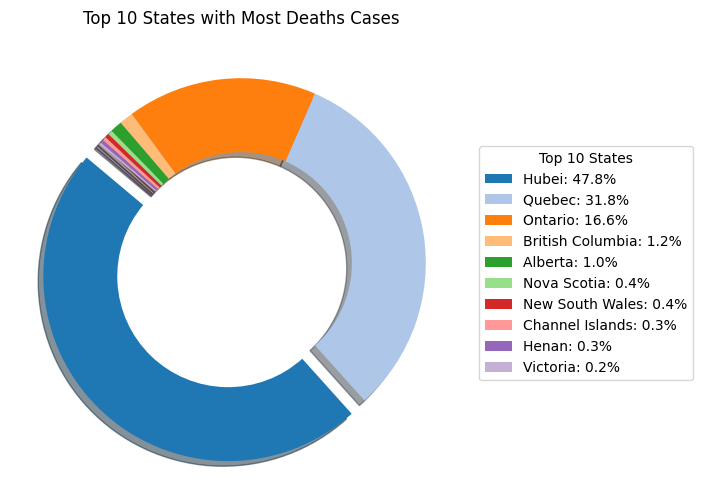

In [ ]:
# Group data by 'Province/State' and sum the 'Deaths' cases
top_10_states = details.groupby("Province/State")["Deaths"].sum().nlargest(10)

# Data for the pie chart
labels = top_10_states.index
sizes = top_10_states.values
colors = plt.cm.tab20.colors
explode = [0.1 if i == 0 else 0 for i in range(10)]  # Highlight top state

# Create Pie Chart without text labels
plt.figure(figsize=(8, 6))
wedges, _ = plt.pie(
    sizes, colors=colors, explode=explode,
    shadow=True, startangle=140, wedgeprops={'width': 0.4}  # Corrected quote here
)

# Add legend with state names and percentages
percentages = [f"{label}: {size / sum(sizes) * 100:.1f}%" for label, size in zip(labels, sizes)]
plt.legend(wedges, percentages, title="Top 10 States", loc="center left", bbox_to_anchor=(1, 0.5))

# Add Title
plt.title('Top 10 States with Most Deaths Cases')

# Show Plot
plt.show()


* Top 10 Recovery Cases Countries

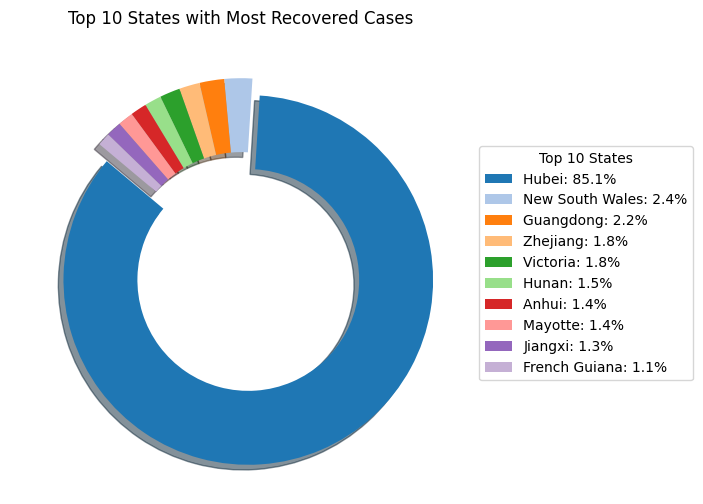

In [ ]:
# Group data by 'Province/State' and sum the 'Recovered' cases
top_10_states = details.groupby("Province/State")["Recovered"].sum().nlargest(10)

# Data for the pie chart
labels = top_10_states.index
sizes = top_10_states.values
colors = plt.cm.tab20.colors
explode = [0.1 if i == 0 else 0 for i in range(10)]  # Highlight top state

# Create Pie Chart without text labels
plt.figure(figsize=(8, 6))
wedges, _ = plt.pie(
    sizes, colors=colors, explode=explode,
    shadow=True, startangle=140, wedgeprops={'width': 0.4}  # Corrected quote here
)

# Add legend with state names and percentages
percentages = [f"{label}: {size / sum(sizes) * 100:.1f}%" for label, size in zip(labels, sizes)]
plt.legend(wedges, percentages, title="Top 10 States", loc="center left", bbox_to_anchor=(1, 0.5))

# Add Title
plt.title('Top 10 States with Most Recovered Cases')
# Show Plot
plt.show()


### Graph of worstly effected Top 5 countries

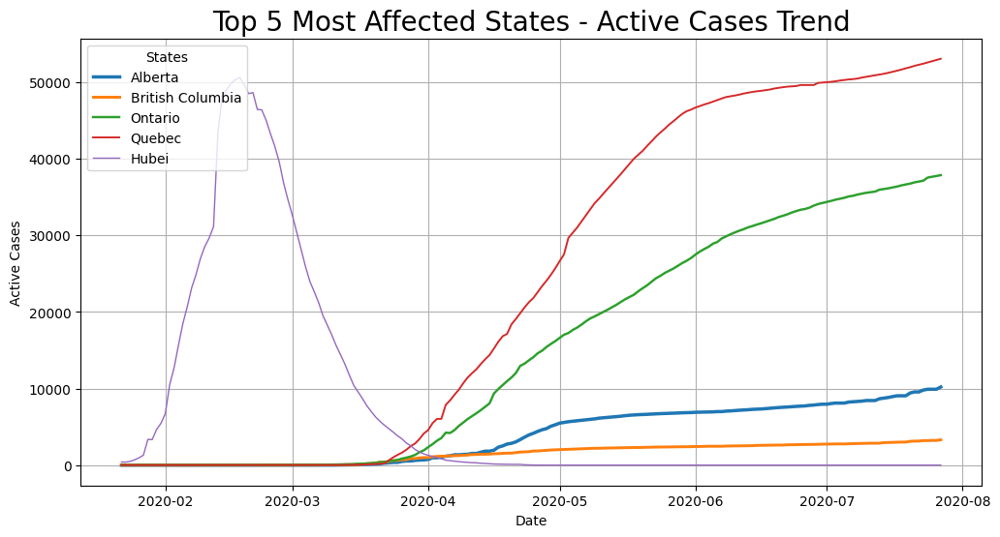

In [ ]:
# Importing necessary libraries
import seaborn as sns

# Identify top 5 states with the most active cases
top_5_states = details.groupby("Province/State")["Active"].sum().nlargest(5).index

# Filter dataset for these top 5 states
filtered_data = details[details['Province/State'].isin(top_5_states)]

# Line plot for the trend of active cases
plt.figure(figsize=(12, 6))
sns.lineplot(
    data=filtered_data,
    x='Date',
    y='Active',
    hue='Province/State',
    size='Province/State',
    sizes=(1, 2.5)  # Controls line thickness
)

# Title and labels
plt.title('Top 5 Most Affected States - Active Cases Trend', size=20)
plt.xlabel('Date')
plt.ylabel('Active Cases')
plt.grid(True)  # Add grid for better readability
plt.legend(title="States", loc='upper left')

# Show plot
plt.show()


### Fatality Rate in different Countries

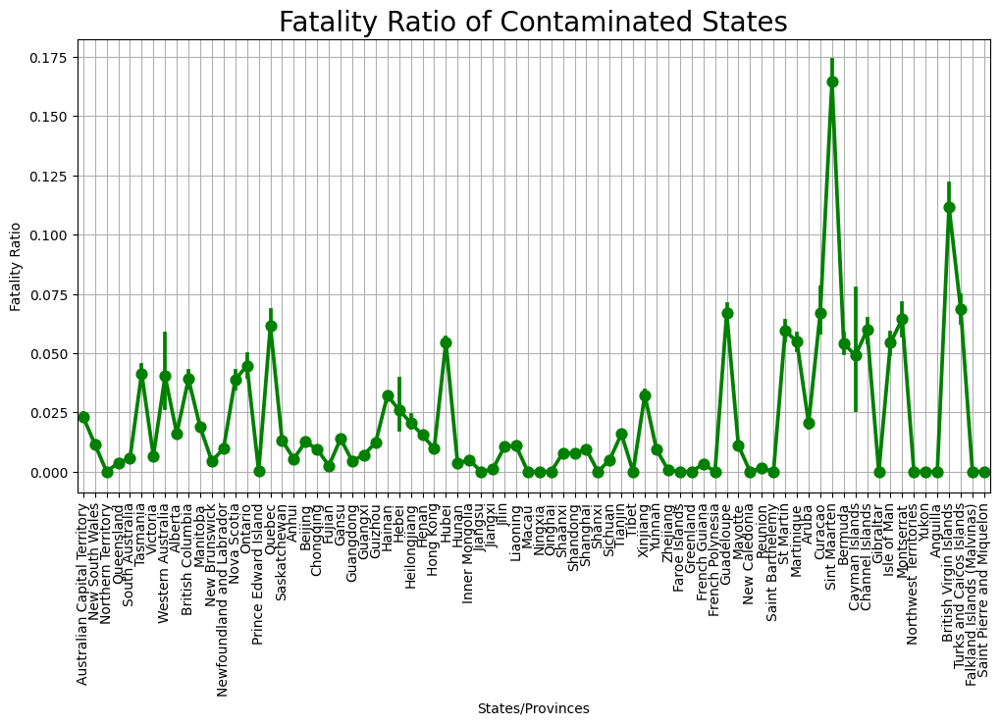

In [ ]:
# Calculate Fatality Ratio in your dataset
details['Fatality_Ratio'] = details['Deaths'] / details['Confirmed']

# Create the plot
plt.figure(figsize=(12, 6))
sns.pointplot(
    data=details,
    x='Province/State',
    y='Fatality_Ratio',
    color='green'
)

# Enhancing the visualization
plt.xticks(rotation=90)  # Rotate state names for better visibility
plt.title('Fatality Ratio of Contaminated States', size=20)
plt.xlabel('States/Provinces')
plt.ylabel('Fatality Ratio')
plt.grid(True)

# Show plot
plt.show()


### Compairing Worstly Affected Countries

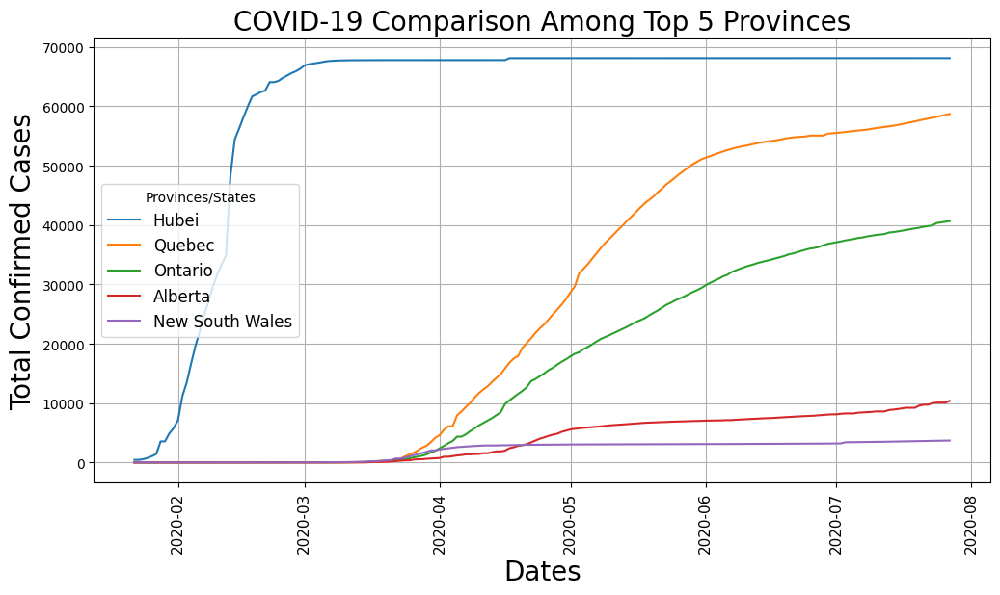

In [ ]:
# Select top 5 affected provinces for comparison
top_5_provinces = details.groupby("Province/State")["Confirmed"].sum().nlargest(5).index

# Extract data for these provinces
dates = details['Date'].unique()  # Extract unique dates
global_confirmed = []

# Collect confirmed case data for each province
for province in top_5_provinces:
    province_data = details[details['Province/State'] == province].groupby('Date')['Confirmed'].sum()
    global_confirmed.append(province_data.values)

# Plotting
plt.figure(figsize=(12, 6))
plt.xticks(rotation=90, fontsize=11)
plt.yticks(fontsize=10)
plt.xlabel("Dates", fontsize=20)
plt.ylabel("Total Confirmed Cases", fontsize=20)
plt.title("COVID-19 Comparison Among Top 5 Provinces", fontsize=20)

# Plot data for each province
for i in range(len(top_5_provinces)):
    plt.plot(dates, global_confirmed[i], label=top_5_provinces[i], linestyle='-')

plt.legend(title="Provinces/States", fontsize=12)
plt.grid(True)
plt.show()


Countries with most active cases

<ipython-input-100-d4445580a496>:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



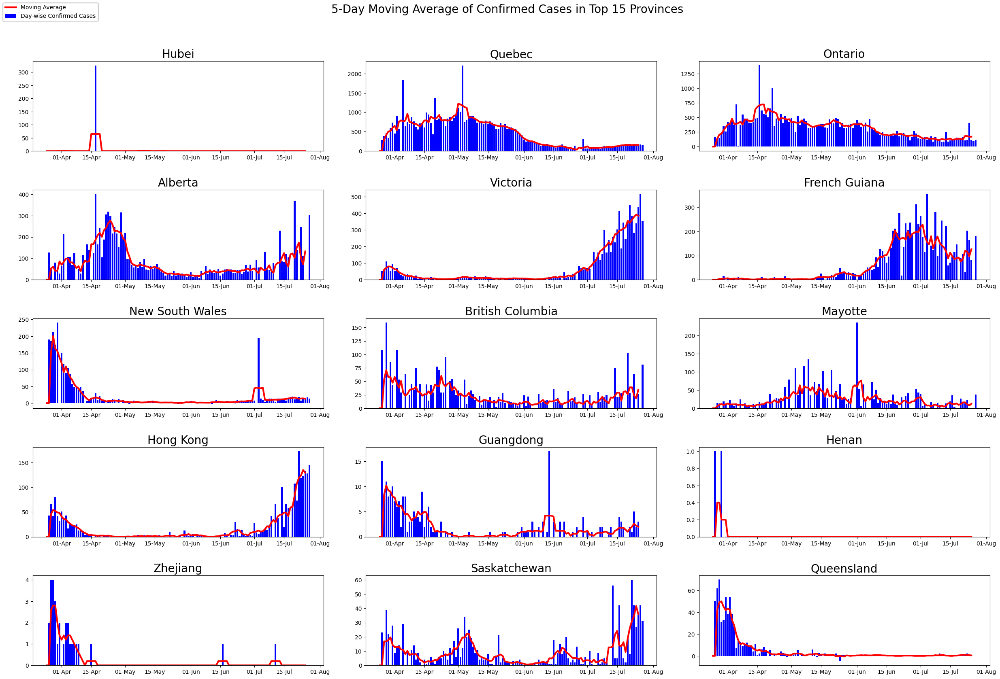

In [ ]:
# Importing necessary libraries
import matplotlib.dates as mdates

# Filter data after a specific date for recent cases
latest = details[details['Date'] > '2020-03-24']

# Calculate 'Active' cases
latest['Active'] = latest['Confirmed'] - (latest['Deaths'] + latest['Recovered'])

# Group and sort by confirmed cases
state_cases = latest.groupby('Province/State')[['Confirmed', 'Deaths', 'Recovered']].max().reset_index()
state_cases = state_cases.sort_values('Confirmed', ascending=False).fillna(0)
states = list(state_cases['Province/State'][:15])  # Top 15 states

# Dictionary to store cases data
states_confirmed = {}
states_dates = {}

# Extract state-wise data
for state in states:
    df = latest[latest['Province/State'] == state].reset_index()
    confirmed_diff = df['Confirmed'].diff().fillna(0).tolist()  # Daily change in confirmed cases
    states_confirmed[state] = confirmed_diff
    states_dates[state] = list(df['Date'])

# Moving Average Calculation Function
def calc_movingaverage(values, N):
    cumsum, moving_aves = [0], [0, 0]
    for i, x in enumerate(values, 1):
        cumsum.append(cumsum[i - 1] + x)
        if i >= N:
            moving_ave = (cumsum[i] - cumsum[i - N]) / N
            moving_aves.append(moving_ave)
    return moving_aves

# Plotting
fig = plt.figure(figsize=(25, 17))
plt.suptitle('5-Day Moving Average of Confirmed Cases in Top 15 Provinces', fontsize=20, y=1.0)

k = 0
for i in range(1, 16):  # For 15 states
    ax = fig.add_subplot(5, 3, i)
    ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%b'))
    ax.bar(states_dates[states[k]], states_confirmed[states[k]], label='Day-wise Confirmed Cases', color='blue')

    # Moving Average Plot
    moving_aves = calc_movingaverage(states_confirmed[states[k]], 5)
    ax.plot(states_dates[states[k]][:-2], moving_aves, color='red', label='Moving Average', linewidth=3)

    plt.title(states[k], fontsize=20)
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper left')

    k += 1

plt.tight_layout(pad=3.0)
plt.show()


## Data visualization
* Confirmed Cases Over Time

<ipython-input-101-9557d8128f35>:2: FutureWarning:



The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.




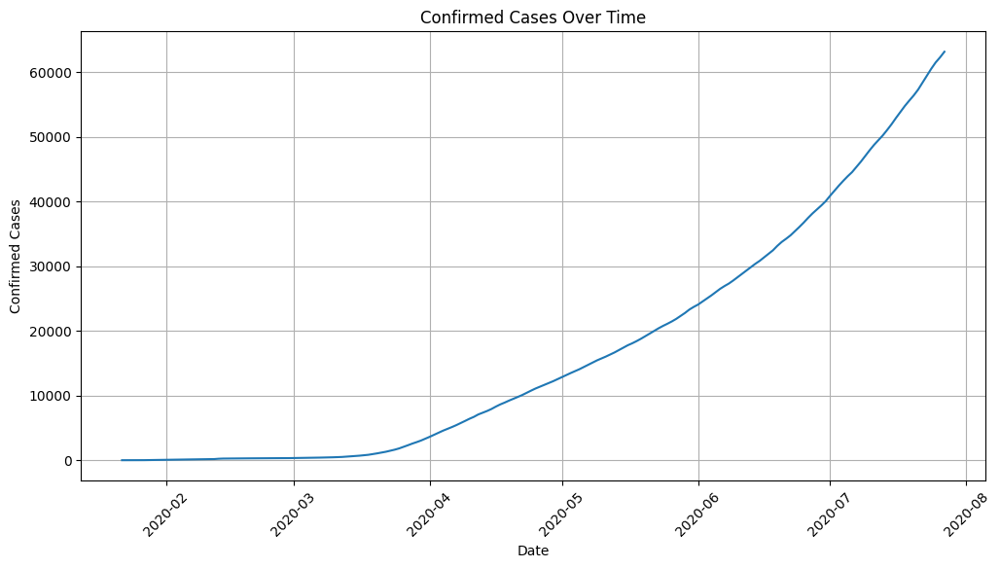

In [ ]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=details, x='Date', y='Confirmed', ci=None)
plt.title("Confirmed Cases Over Time")
plt.xlabel("Date")
plt.ylabel("Confirmed Cases")
plt.xticks(rotation=45)
plt.grid()
plt.show()

* Heatmap for Correlation Analysis

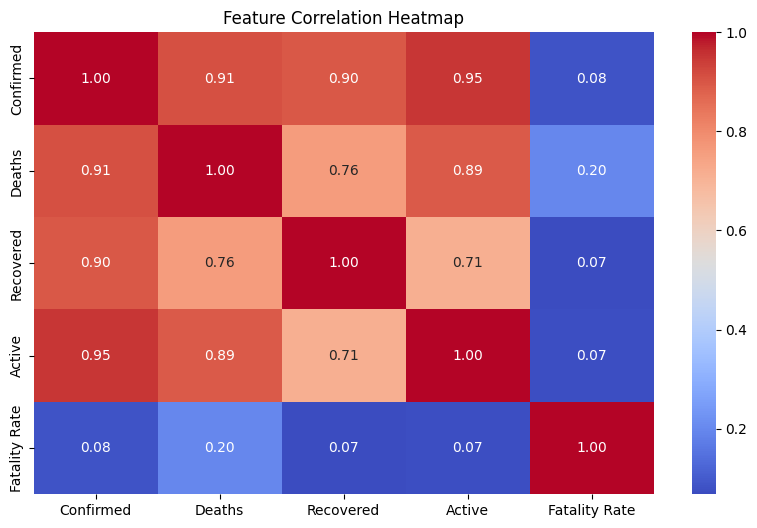

In [ ]:
plt.figure(figsize=(10, 6))
sns.heatmap(details[['Confirmed', 'Deaths', 'Recovered', 'Active', 'Fatality Rate']].corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Feature Correlation Heatmap")
plt.show()

* Top 10 affected countries

<ipython-input-103-36614b7f89ed>:3: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




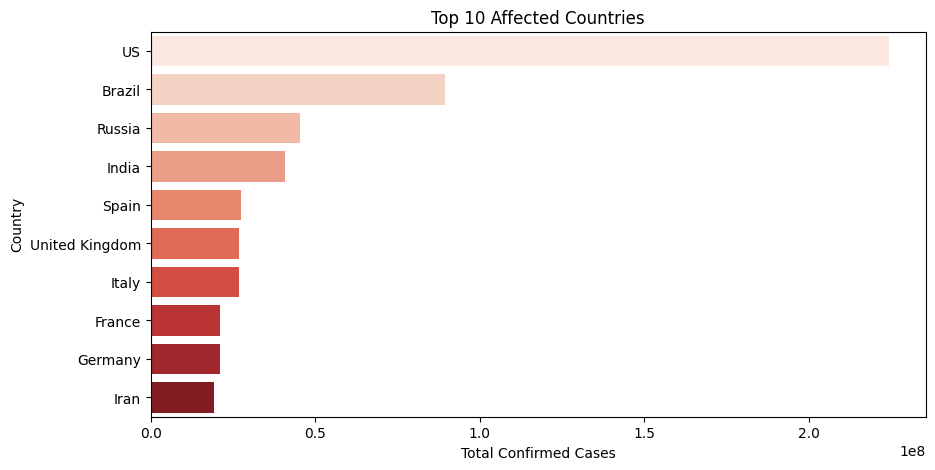

In [ ]:
top_countries = details.groupby('Country/Region')['Confirmed'].sum().sort_values(ascending=False).head(10)
plt.figure(figsize=(10, 5))
sns.barplot(y=top_countries.index, x=top_countries.values, palette="Reds")
plt.title("Top 10 Affected Countries")
plt.xlabel("Total Confirmed Cases")
plt.ylabel("Country")
plt.show()

* Box Plot for Active Ratio & Fatality Rate

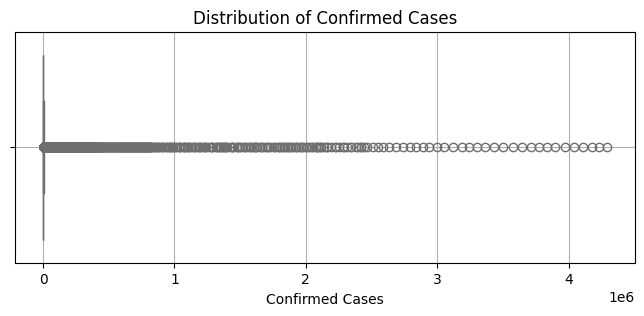

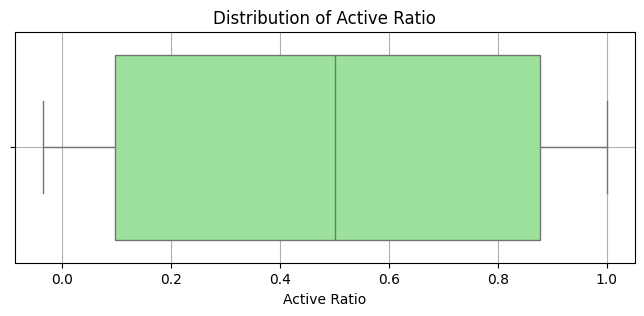

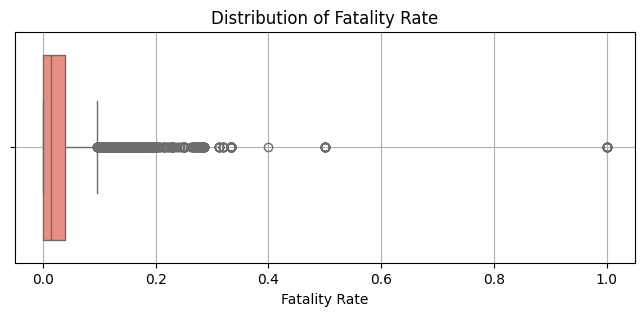

In [ ]:
# Data visualization
# Box Plot for Confirmed Cases
plt.figure(figsize=(8, 3))
sns.boxplot(x=details['Confirmed'], color='skyblue')
plt.title('Distribution of Confirmed Cases')
plt.xlabel('Confirmed Cases')
plt.grid(True)
plt.show()

# Box Plot for Active Ratio
plt.figure(figsize=(8, 3))
sns.boxplot(x=details['Active Ratio'], color='lightgreen')
plt.title('Distribution of Active Ratio')
plt.xlabel('Active Ratio')
plt.grid(True)
plt.show()

# Box Plot for Fatality Rate
plt.figure(figsize=(8, 3))
sns.boxplot(x=details['Fatality Rate'], color='salmon')
plt.title('Distribution of Fatality Rate')
plt.xlabel('Fatality Rate')
plt.grid(True)
plt.show()

* Scatter Plot

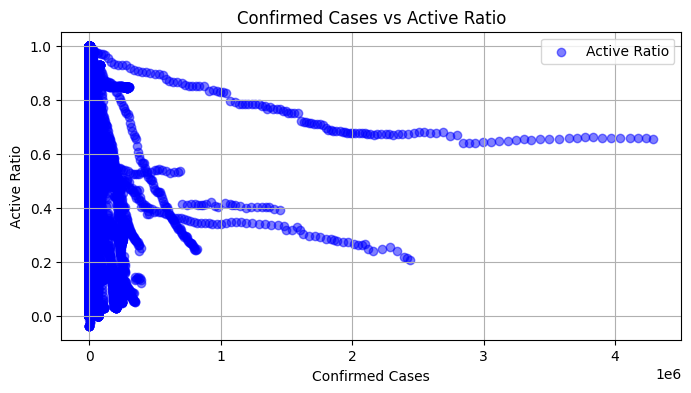

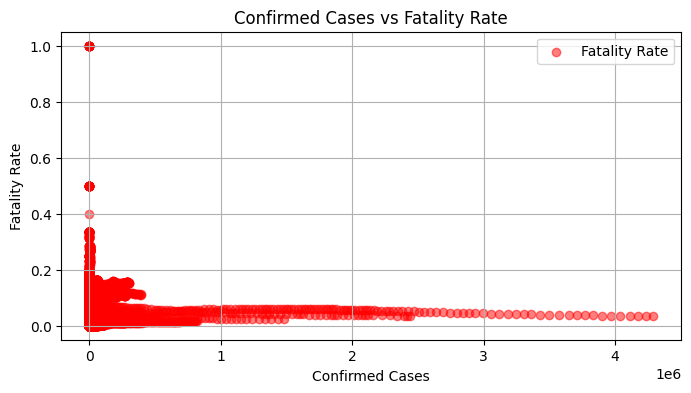

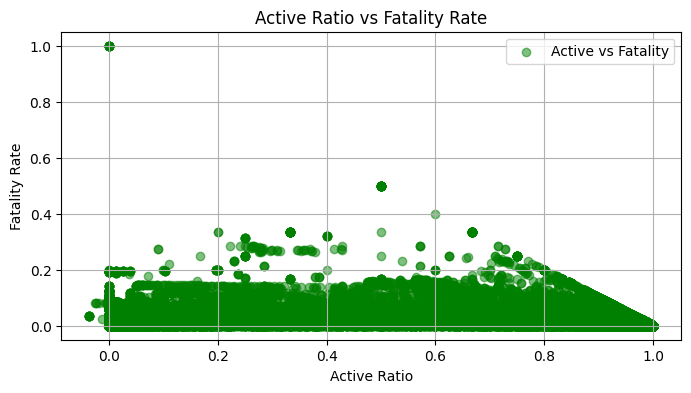

In [ ]:
# Scatter Plot: Confirmed Cases vs Active Ratio
plt.figure(figsize=(8, 4))
plt.scatter(details['Confirmed'], details['Active Ratio'], alpha=0.5, c='blue', label='Active Ratio')
plt.title('Confirmed Cases vs Active Ratio')
plt.xlabel('Confirmed Cases')
plt.ylabel('Active Ratio')
plt.grid(True)
plt.legend()
plt.show()

# Scatter Plot: Confirmed Cases vs Fatality Rate
plt.figure(figsize=(8, 4))
plt.scatter(details['Confirmed'], details['Fatality Rate'], alpha=0.5, c='red', label='Fatality Rate')
plt.title('Confirmed Cases vs Fatality Rate')
plt.xlabel('Confirmed Cases')
plt.ylabel('Fatality Rate')
plt.grid(True)
plt.legend()
plt.show()

# Scatter Plot: Active Ratio vs Fatality Rate
plt.figure(figsize=(8, 4))
plt.scatter(details['Active Ratio'], details['Fatality Rate'], alpha=0.5, c='green', label='Active vs Fatality')
plt.title('Active Ratio vs Fatality Rate')
plt.xlabel('Active Ratio')
plt.ylabel('Fatality Rate')
plt.grid(True)
plt.legend()
plt.show()

### Handling Missing and Infinte Values

In [ ]:
# Importing necessary libraries
from scipy.stats import pearsonr

# Correlation between Confirmed Cases and Deaths
corr, _ = pearsonr(details['Confirmed'], details['Deaths'])
print(f"Correlation between Confirmed Cases and Deaths: {corr:.2f}")

Correlation between Confirmed Cases and Deaths: 0.91


In [ ]:
details.isna().sum()

,0
Province/State,34404
Country/Region,0
Lat,0
Long,0
Date,0
Confirmed,0
Deaths,0
Recovered,0
Active,0
WHO Region,0


In [ ]:
cases = ['Confirmed', 'Deaths', 'Recovered', 'Active']
details['total_cases']=details['Confirmed'] + details['Deaths'] + details['Recovered']
# Active Case = confirmed - deaths - recovered
details['Active'] = details['Confirmed'] - details['Deaths'] - details['Recovered']
# replacing Mainland china with just China
details['Country/Region'] = details['Country/Region'].replace('Mainland China', 'China')

# filling missing values
details[['Province/State']] = details[['Province/State']].fillna('')
details[cases] = details[cases].fillna(0)

# fixing datatypes
details['Recovered'] = details['Recovered'].astype(int)

details.sample(6)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Year,Month,Active Ratio,Fatality Rate,Fatality_Ratio,total_cases
30766,,Dominica,15.415000,-61.371000,2020-05-18,16,0,16,0,Americas,2020,5,0.000000,0.000000,0.000000,32
45546,,Iraq,33.223191,43.679291,2020-07-14,81757,3345,50782,27630,Eastern Mediterranean,2020,7,0.337953,0.040914,0.040914,135884
641,,Ghana,7.946500,-1.023200,2020-01-24,0,0,0,0,Africa,2020,1,NaN,NaN,NaN,0
3603,,Tunisia,33.886917,9.537499,2020-02-04,0,0,0,0,Eastern Mediterranean,2020,2,NaN,NaN,NaN,0
9200,Jiangxi,China,27.614000,115.722100,2020-02-26,934,1,719,214,Western Pacific,2020,2,0.229122,0.001071,0.001071,1654
4126,,Turkey,38.963700,35.243300,2020-02-06,0,0,0,0,Europe,2020,2,NaN,NaN,NaN,0


### Daywise Aggrigate cases

In [ ]:
temp = details.groupby('Date')[['Confirmed', 'Deaths', 'Recovered', 'Active']].sum().reset_index()
temp = temp[temp['Date'] == max(temp['Date'])].reset_index(drop=True)
temp['Global Mortality'] = temp['Deaths'] / temp['Confirmed']
temp['Deaths per 100 Confirmed Cases'] = temp['Global Mortality'] * 100
temp.style.background_gradient(cmap='Pastel1')

,Date,Confirmed,Deaths,Recovered,Active,Global Mortality,Deaths per 100 Confirmed Cases
0,2020-07-27 00:00:00,16480485,654036,9468087,6358362,0.039685,3.968548


In [ ]:
full_latest = details[details['Date'] == max(details['Date'])].reset_index()
full_latest_grouped = full_latest.groupby('Country/Region')[['Confirmed', 'Deaths', 'Recovered', 'Active']].sum().reset_index()

temp_f = full_latest_grouped.sort_values(by='Confirmed', ascending=False)
temp_f = temp_f[['Country/Region', 'Confirmed', 'Active', 'Deaths', 'Recovered']]
temp_f = temp_f.reset_index(drop=True)

temp_f.style.background_gradient(cmap="Blues", subset=['Confirmed', 'Active'])\
       .background_gradient(cmap="Greens", subset=['Recovered'])\
       .background_gradient(cmap="Reds", subset=['Deaths'])

,Country/Region,Confirmed,Active,Deaths,Recovered
0,US,4290259,2816444,148011,1325804
1,Brazil,2442375,508116,87618,1846641
2,India,1480073,495499,33408,951166
3,Russia,816680,201097,13334,602249
4,South Africa,452529,170537,7067,274925
5,Mexico,395489,47657,44022,303810
6,Peru,389717,98752,18418,272547
7,Chile,347923,18782,9187,319954
8,United Kingdom,301708,254427,45844,1437
9,Iran,293606,22550,15912,255144


In [ ]:
temp_flg = temp_f[temp_f['Deaths']>0][['Country/Region', 'Deaths']]
temp_flg['Deaths / 100 Cases'] = round((temp_f['Deaths']/temp_f['Confirmed'])*100, 2)
temp_flg.sort_values('Deaths', ascending=False).reset_index(drop=True).style.background_gradient(cmap='Reds')

,Country/Region,Deaths,Deaths / 100 Cases
0,US,148011,3.450000
1,Brazil,87618,3.590000
2,United Kingdom,45844,15.190000
3,Mexico,44022,11.130000
4,Italy,35112,14.260000
5,India,33408,2.260000
6,France,30212,13.710000
7,Spain,28432,10.440000
8,Peru,18418,4.730000
9,Iran,15912,5.420000


In [ ]:
import plotly.express as px
import numpy as np  # Since np is used, ensure NumPy is imported

# Choropleth map for confirmed cases
fig = px.choropleth(full_latest_grouped,
                    locations="Country/Region",
                    locationmode='country names',
                    color=np.log(full_latest_grouped["Confirmed"]),
                    hover_name="Country/Region",
                    hover_data=['Confirmed'],
                    color_continuous_scale="peach",
                    title='Countries with Confirmed Cases')

fig.update(layout_coloraxis_showscale=False)
fig.show()


In [ ]:
# Deaths
temp = full_latest_grouped[full_latest_grouped['Deaths']>0]
fig = px.choropleth(temp,
                    locations="Country/Region", locationmode='country names',
                    color=np.log(temp["Deaths"]), hover_name="Country/Region",
                    color_continuous_scale="Peach", hover_data=['Deaths'],
                    title='Countries with Deaths Reported')
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [ ]:
formated_gdf = details.groupby(['Date', 'Country/Region'])[['Confirmed', 'Deaths']].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Confirmed'].pow(0.3)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names',
                     color="Confirmed", size='size', hover_name="Country/Region",
                     range_color= [0, max(formated_gdf['Confirmed'])+2], animation_frame="Date",
                     title='Spread over time')
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [ ]:
formated_gdf = details.groupby(['Date', 'Country/Region'])[['Recovered', 'Deaths']].max()
formated_gdf = formated_gdf.reset_index()
formated_gdf['Date'] = pd.to_datetime(formated_gdf['Date'])
formated_gdf['Date'] = formated_gdf['Date'].dt.strftime('%m/%d/%Y')
formated_gdf['size'] = formated_gdf['Recovered'].pow(0.3)

fig = px.scatter_geo(formated_gdf, locations="Country/Region", locationmode='country names',
                     color="Recovered", size='size', hover_name="Country/Region",
                     range_color= [0, max(formated_gdf['Recovered'])+2], animation_frame="Date",
                     title='Recovery over time')
fig.update(layout_coloraxis_showscale=False)
fig.show()

In [ ]:
full_latest_grouped = full_latest.groupby('Country/Region')[[ 'Confirmed', 'Deaths', 'Recovered','Active','Lat','Long']].sum().reset_index()

In [ ]:
full_latest_grouped.head()

,Country/Region,Confirmed,Deaths,Recovered,Active,Lat,Long
0,Afghanistan,36263,1269,25198,9796,33.93911,67.709953
1,Albania,4880,144,2745,1991,41.15330,20.168300
2,Algeria,27973,1163,18837,7973,28.03390,1.659600
3,Andorra,907,52,803,52,42.50630,1.521800
4,Angola,950,41,242,667,-11.20270,17.873900


In [ ]:
# Importing necessary libraries
import folium

# Create a map
m = folium.Map(location=[54, 15], tiles='openstreetmap', zoom_start=2)

# Add points to the map
for idx, row in full_latest_grouped.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=str(row['Confirmed'])).add_to(m)

# Display the map
m

In [ ]:
# Create a map
m = folium.Map(location=[54, 15], tiles='openstreetmap', zoom_start=2)

# Add points to the map
for idx, row in full_latest_grouped.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=str(row['Recovered'])).add_to(m)

# Display the map
m

In [ ]:
# Create a map
m = folium.Map(location=[54, 15], tiles='openstreetmap', zoom_start=2)

# Add points to the map
for idx, row in full_latest_grouped.iterrows():
    folium.Marker([row['Lat'], row['Long']], popup=str(row['Deaths'])).add_to(m)

# Display the map
m

In [ ]:
# Importing necessary libraries
from folium.plugins import HeatMap  # Import HeatMap

# Create map
m = folium.Map(location=[54, 15], zoom_start=2)

# Add HeatMap layer
HeatMap(data=full_latest_grouped[['Lat', 'Long']], radius=15).add_to(m)

# Show the map
m

In [ ]:
# Importing necessary libraries
import folium
from folium.plugins import MarkerCluster  # Import MarkerCluster
import math

# Create map
m = folium.Map(location=[54, 15], tiles='cartodbpositron', zoom_start=2)

# Add points using MarkerCluster
mc = MarkerCluster()
for idx, row in full_latest_grouped.iterrows():
    if not math.isnan(row['Long']) and not math.isnan(row['Lat']):
        mc.add_child(folium.Marker([row['Lat'], row['Long']]))  # Use folium.Marker

m.add_child(mc)

# Display the map
m

In [ ]:
# Create map with overall cases registered
m = folium.Map(location=[54,15], zoom_start=2)
HeatMap(data=details[['Lat', 'Long']], radius=15).add_to(m)

# Show the map
m

In [ ]:
# Create map
m = folium.Map(location=[54, 15], tiles='cartodbpositron', zoom_start=2)

# Add points using MarkerCluster
mc = MarkerCluster()
for idx, row in details.iterrows():
    if not math.isnan(row['Long']) and not math.isnan(row['Lat']):
        mc.add_child(folium.Marker([row['Lat'], row['Long']]))

m.add_child(mc)

# Display the map
m

In [ ]:
details.to_csv('covid_19_clean_complete_with_ratios.csv', index=False)

In [ ]:
details.head(10)

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region,Year,Month,Active Ratio,Fatality Rate,Fatality_Ratio,total_cases
0,,Afghanistan,33.93911,67.709953,2020-01-22,0,0,0,0,Eastern Mediterranean,2020,1,NaN,NaN,NaN,0
1,,Albania,41.15330,20.168300,2020-01-22,0,0,0,0,Europe,2020,1,NaN,NaN,NaN,0
2,,Algeria,28.03390,1.659600,2020-01-22,0,0,0,0,Africa,2020,1,NaN,NaN,NaN,0
3,,Andorra,42.50630,1.521800,2020-01-22,0,0,0,0,Europe,2020,1,NaN,NaN,NaN,0
4,,Angola,-11.20270,17.873900,2020-01-22,0,0,0,0,Africa,2020,1,NaN,NaN,NaN,0
5,,Antigua and Barbuda,17.06080,-61.796400,2020-01-22,0,0,0,0,Americas,2020,1,NaN,NaN,NaN,0
6,,Argentina,-38.41610,-63.616700,2020-01-22,0,0,0,0,Americas,2020,1,NaN,NaN,NaN,0
7,,Armenia,40.06910,45.038200,2020-01-22,0,0,0,0,Europe,2020,1,NaN,NaN,NaN,0
8,Australian Capital Territory,Australia,-35.47350,149.012400,2020-01-22,0,0,0,0,Western Pacific,2020,1,NaN,NaN,NaN,0
9,New South Wales,Australia,-33.86880,151.209300,2020-01-22,0,0,0,0,Western Pacific,2020,1,NaN,NaN,NaN,0


In [7]:
details_grouped = details.groupby(["Date", "Country/Region", "Lat", "Long"]).sum().reset_index()
dates = sorted(details_grouped["Date"].unique())

# Remove duplicate countries to get one lat-long per country
country_coords = {}

# This picks the first occurrence of each country with its Lat and Long
for _, row in details.drop_duplicates(subset=['Country/Region']).iterrows():
    country_coords[row['Country/Region']] = (row['Lat'], row['Long'])


In [11]:
# Ensure Date is datetime
details['Date'] = pd.to_datetime(details['Date'])

# Filter rows with >0 cases
infected_details = details[details['Confirmed'] > 0]

# Find first infection date per country
first_case = infected_details.groupby('Country/Region')['Date'].min()

In [12]:
edges = []

countries = list(first_case.index)

for target in countries:
    target_date = first_case[target]
    target_lat, target_lon = country_coords[target]

    # Get possible sources: countries that had cases before target
    possible_sources = [src for src in countries if first_case[src] < target_date]

    if not possible_sources:
        continue  # skip first infected country

    # Pick nearest source country
    min_dist = float('inf')
    source_country = None

    for src in possible_sources:
        src_lat, src_lon = country_coords[src]
        dist = ((src_lat - target_lat)**2 + (src_lon - target_lon)**2)**0.5  # simple Euclidean

        if dist < min_dist:
            min_dist = dist
            source_country = src

    # Save the edge: (src_lat, src_lon, tgt_lat, tgt_lon, tgt_date)
    if source_country:
        slat, slon = country_coords[source_country]
        tlat, tlon = target_lat, target_lon
        spread_date = target_date

        edges.append((slat, slon, tlat, tlon, spread_date))


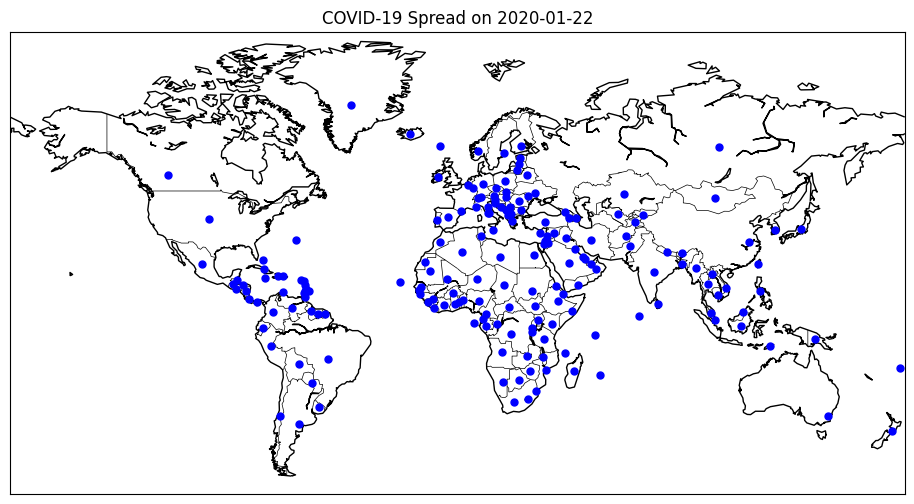

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
from matplotlib.animation import FuncAnimation

# Sample data:
# country_first_case = {'CountryA': dateA, 'CountryB': dateB, ...}
# edges = [(source_lat, source_lon, target_lat, target_lon, spread_date), ...]

# Load your data and compute country_first_case and edges here

fig, ax = plt.subplots(figsize=(12, 6))
m = Basemap(projection='mill', llcrnrlat=-60, urcrnrlat=85,
            llcrnrlon=-180, urcrnrlon=180, ax=ax)

def update(frame):
    ax.clear()
    m.drawcoastlines()
    m.drawcountries()

    current_date = dates[frame]
    ax.set_title(f'COVID-19 Spread on {current_date.date()}')

    # Draw countries as dots
    for country, (lat, lon) in country_coords.items():
        x, y = m(lon, lat)
        ax.plot(x, y, 'bo', markersize=5)

    # Draw directional arrows from source to target
    for (slat, slon, tlat, tlon, spread_date) in edges:
        if spread_date <= current_date:
            x_start, y_start = m(slon, slat)
            x_end, y_end = m(tlon, tlat)

            ax.annotate(
                '',
                xy=(x_end, y_end), xycoords='data',
                xytext=(x_start, y_start), textcoords='data',
                arrowprops=dict(
                    arrowstyle="->",
                    color='red',
                    lw=2,
                    alpha=0.7
                )
            )


ani = FuncAnimation(fig, update, frames=len(dates), interval=500)
ani.save('covid_spread_lines.mp4', writer='ffmpeg')


### Conclusion

* In this project, we analyzed the impact of COVID-19 by aggregating and visualizing key metrics such as confirmed cases, deaths, recoveries, and active cases. By computing global fatality rates and deaths per 100 confirmed cases, we gained insights into the severity of the pandemic over time. The use of data visualization techniques helped highlight trends and patterns in the outbreak. This study reinforces the importance of real-time data monitoring and analysis in managing public health crises. Future work can include predictive modeling to forecast case trends and evaluate the effectiveness of mitigation measures.